In [ ]:

# Sample notebook - version 1

# Python 3.8.5

# VSCode Version: 1.90.2 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from joblib import Parallel, delayed
import time
import os
import ipywidgets as widgets
from IPython.display import display, clear_output
from scipy.ndimage import gaussian_filter
from tqdm.notebook import tqdm

%matplotlib widget

# Global variables
fig = None
ax = None
im = None
x = None
y = None
raw_data = None
stretched_data = None
sharpening_status = False
status_text = None

# Define figure sizes
DEFAULT_FIG_SIZE = (15, 13)    # (width, height)
SHARPENED_FIG_SIZE = (20, 13)  # (width, height)

# 1. Add the print_elapsed_time function
def print_elapsed_time(start_time, description):
    elapsed_time = time.time() - start_time
    print(f"Elapsed time for {description}: {elapsed_time:.4f} seconds")

# 2. Define stretch functions
def linear_stretch(data):
    return data

def sqrt_stretch(data):
    return np.sqrt(data - np.min(data))

def log_stretch(data):
    return np.log1p(data - np.min(data))

def arcsinh_stretch(data):
    return np.arcsinh(data - np.min(data))

stretch_functions = {
    'Linear': linear_stretch,
    'Square Root': sqrt_stretch,
    'Logarithmic': log_stretch,
    'Arcsinh': arcsinh_stretch
}

stretch_descriptions = {
    'Linear': 'Linear stretch: No change, useful as a reference.',
    'Square Root': 'Square Root stretch: Enhances faint features while compressing brighter areas.',
    'Logarithmic': 'Logarithmic stretch: Strong enhancement of faint features, good for high dynamic range data.',
    'Arcsinh': 'Arcsinh stretch: Similar to logarithmic, but better behaved near zero and with negative values.'
}

# 7. Apply stretch function
def apply_stretch(data, stretch_type):
    stretch_func = stretch_functions[stretch_type]
    chunks = np.array_split(data, os.cpu_count())
    results = Parallel(n_jobs=-1)(delayed(stretch_func)(chunk) for chunk in chunks)
    return np.concatenate(results)

# 8. Update stretch function
def update_stretch(change):
    global stretched_data, im
    new_stretch = change['new']
    stretched_data = apply_stretch(raw_data, new_stretch)
    im.set_data(stretched_data)
    stretch_description.value = stretch_descriptions[new_stretch]
    fig.canvas.draw_idle()

# 9. Update colormap function
def update_cmap(change):
    new_cmap = change['new']
    if new_cmap.endswith('_r'):
        im.set_cmap(plt.get_cmap(new_cmap[:-2]).reversed())
    else:
        im.set_cmap(new_cmap)
    fig.canvas.draw_idle()

# 10. Update contrast function
def update_contrast(change):
    im.set_clim(vmin=change['new'][0], vmax=change['new'][1])
    fig.canvas.draw_idle()

# 11. Zoom in function
def zoom_in(b):
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    x_center = (xlim[1] + xlim[0]) / 2
    y_center = (ylim[1] + ylim[0]) / 2
    x_range = xlim[1] - xlim[0]
    y_range = ylim[1] - ylim[0]
    ax.set_xlim(x_center - x_range/4, x_center + x_range/4)
    ax.set_ylim(y_center - y_range/4, y_center + y_range/4)
    fig.canvas.draw_idle()

# 12. Reset view function
def reset_view(b):
    ax.set_xlim(x.min(), x.max())
    ax.set_ylim(y.min(), y.max())
    fig.canvas.draw_idle()

# 13. Update sharpening status function
def update_sharpening_status():
    global status_text
    if status_text:
        status_text.remove()
    status_text = ax.text(0.02, 0.98, f"Sharpening: {'On' if sharpening_status else 'Off'}",
                          transform=ax.transAxes, fontsize=10,
                          verticalalignment='top', bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
    fig.canvas.draw_idle()

# 14. Apply sharpening function
def apply_sharpening(change_size=False):
    global im, sharpening_status
    blurred = gaussian_filter(stretched_data, sigma=1)
    sharpened = stretched_data + (stretched_data - blurred)
    im.set_data(sharpened)
    sharpening_status = True
    update_sharpening_status()
    if change_size:
        fig.set_size_inches(SHARPENED_FIG_SIZE)
        plt.subplots_adjust(left=0, right=1, top=1, bottom=0)
    fig.canvas.draw_idle()

# 15. Sharpen default function
def sharpen_default(b):
    apply_sharpening(change_size=False)

# 16. Sharpen large function
def sharpen_large(b):
    apply_sharpening(change_size=True)

# 17. Reset sharpening function
def reset_sharpening(b):
    global im, sharpening_status
    im.set_data(stretched_data)
    sharpening_status = False
    update_sharpening_status()
    fig.set_size_inches(DEFAULT_FIG_SIZE)
    plt.subplots_adjust(left=0, right=1, top=1, bottom=0)
    fig.canvas.draw_idle()

# 18. Create plot function
def create_plot(image_path):
    global fig, ax, im, x, y, raw_data, stretched_data, stretch_description
    total_start_time = time.time()

    print("# 18. create_plot")

    print("# 19. Read the FITS image")
    start_time = time.time()
    with fits.open(image_path) as hdul:
        raw_data = hdul[1].data
    print("data: " + str(raw_data.shape))
    print_elapsed_time(start_time, "Reading FITS image")

    # 20. Downsample the data (optional)
    start_time = time.time()
    factor = 10  # Increase this factor for more aggressive downsampling
    raw_data = raw_data[::factor, ::factor]
    print("20. downsampled data: " + str(raw_data.shape))
    print_elapsed_time(start_time, "Downsampling data")

    print("# 21. Apply initial stretch (Linear)")
    start_time = time.time()
    stretched_data = apply_stretch(raw_data, 'Linear')
    print_elapsed_time(start_time, "Applying initial stretch")

    print("#23. Create an image plot")
    start_time = time.time()

    print("# 24. Clear any existing figures")
    plt.close('all')

    print("# 25. Create a single figure and axis")
    fig, ax = plt.subplots(figsize=DEFAULT_FIG_SIZE)

    # Remove axes
    ax.set_axis_off()

    # Create the image plot
    im = ax.imshow(stretched_data, cmap='viridis', vmin=0.2, vmax=2.0, aspect='equal')

    # Adjust the plot to fill the figure
    plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

    update_sharpening_status()
    print_elapsed_time(start_time, "Creating and displaying image plot")
    print_elapsed_time(total_start_time, "Total execution")

    print("25b.Interact with the plot to change colormaps, zoom, or apply sharpening.")

    print("# 26. Create the stretch function dropdown")
    stretch_dropdown = widgets.Dropdown(
        options=list(stretch_functions.keys()),
        value='Arcsinh',
        description='Stretch:',
        layout=widgets.Layout(width='200px')
    )
    stretch_dropdown.observe(update_stretch, names='value')

    print("# 27. Create the colormap dropdown")
    cmap_options = ['viridis', 'plasma', 'inferno', 'magma', 'cividis', 'gray', 'hot', 'rainbow', 
                    'cubehelix', 'twilight', 'coolwarm', 'RdYlBu', 'gist_earth', 'nipy_spectral', 'turbo']
    cmap_options_with_reverse = cmap_options + [cmap + '_r' for cmap in cmap_options]
    cmap_dropdown = widgets.Dropdown(
        options=cmap_options_with_reverse,
        value='viridis',
        description='Colormap:',
        layout=widgets.Layout(width='200px')
    )
    cmap_dropdown.observe(update_cmap, names='value')

    print("# 28. Create the stretch description text box")
    stretch_description = widgets.Text(
        value=stretch_descriptions['Arcsinh'],
        description='Description:',
        layout=widgets.Layout(width='800px'),  # 800px width
        disabled=True
    )

    print("# 29. Create the contrast slider")
    contrast_slider = widgets.FloatRangeSlider(
        value=[0.2, 2.0],
        min=0.0,
        max=5.0,
        step=0.1,
        description='Contrast:',
        continuous_update=False,
        layout=widgets.Layout(width='400px')
    )
    contrast_slider.observe(update_contrast, names='value')

    print("# 30. Create the zoom radio buttons")
    zoom_radio = widgets.RadioButtons(
        options=['None', 'Zoom In', 'Reset View'],
        value='None',  # Start with 'None' selected
        description='Zoom:',
        disabled=False
    )
    zoom_radio.observe(lambda change: zoom_in(None) if change['new'] == 'Zoom In' else (reset_view(None) if change['new'] == 'Reset View' else None), names='value')

    print("# 31. Create the sharpening radio buttons")
    sharpen_radio = widgets.RadioButtons(
        options=['None', 'Sharpen (Default Size)', 'Sharpen (Large Size)', 'Reset Sharpening'],
        value='None',  # Start with 'None' selected
        description='Sharpen:',
        disabled=False
    )
    sharpen_radio.observe(lambda change: sharpen_default(None) if change['new'] == 'Sharpen (Default Size)'
                          else (sharpen_large(None) if change['new'] == 'Sharpen (Large Size)'
                                else (reset_sharpening(None) if change['new'] == 'Reset Sharpening' else None)), names='value')

    print("# 32. Create a vertical box layout for all controls")
    control_box = widgets.VBox([
        widgets.HBox([stretch_dropdown, cmap_dropdown]),
        stretch_description,
        contrast_slider,
        zoom_radio,
        sharpen_radio
    ])

    print("# 33. Display all controls")
    display(control_box)

    print("# 34. Display the figure")
    plt.show()

    print("\nDone!")

### Stephans Quintet NGC 7320   - https://en.wikipedia.org/wiki/NGC_7320

# 18. create_plot
# 19. Read the FITS image
data: (12481, 14586)
Elapsed time for Reading FITS image: 0.4022 seconds
20. downsampled data: (1249, 1459)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 7.8550 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0320 seconds
Elapsed time for Total execution: 8.2904 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


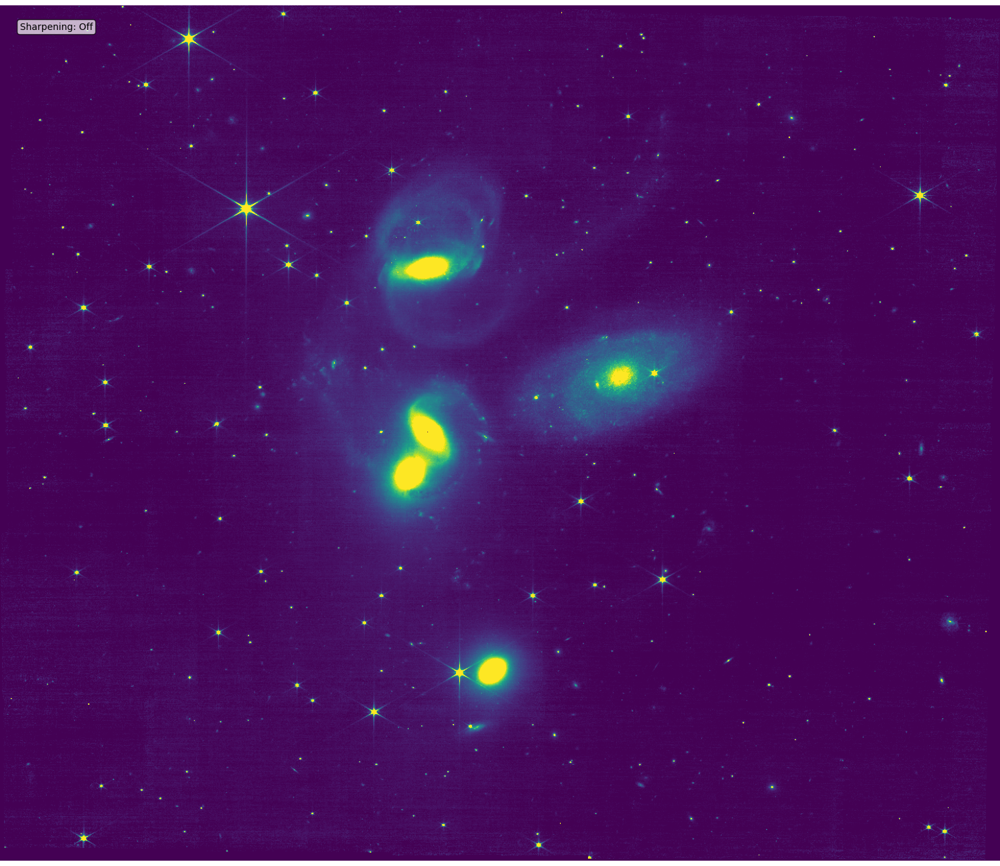


Done!


In [3]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F090W/JWST/jw02732-o001_t001_nircam_clear-f090w/jw02732-o001_t001_nircam_clear-f090w_i2d.fits'

create_plot(image)

In [ ]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F090W/JWST/jw02732-o001_t001_nircam_clear-f090w/jw02732-o001_t001_nircam_clear-f090w_i2d.fits'

create_plot(image)

# 18. create_plot
# 19. Read the FITS image
data: (12375, 14426)
Elapsed time for Reading FITS image: 0.5350 seconds
20. downsampled data: (1238, 1443)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 6.1600 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0178 seconds
Elapsed time for Total execution: 6.7131 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


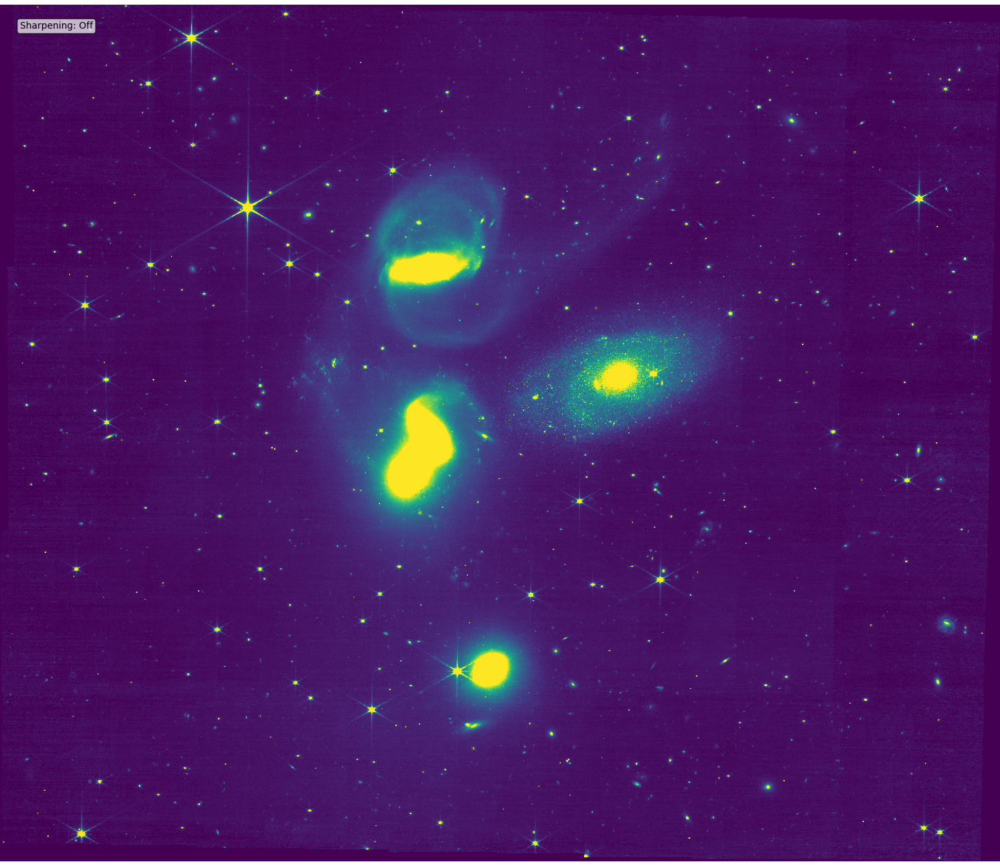


Done!


In [4]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F150W/JWST/jw02732-o001_t001_nircam_clear-f150w/jw02732-o001_t001_nircam_clear-f150w_i2d.fits'

create_plot(image)

# 18. create_plot
# 19. Read the FITS image
data: (12487, 14593)
Elapsed time for Reading FITS image: 0.3705 seconds
20. downsampled data: (1249, 1460)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 6.2340 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0147 seconds
Elapsed time for Total execution: 6.6196 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


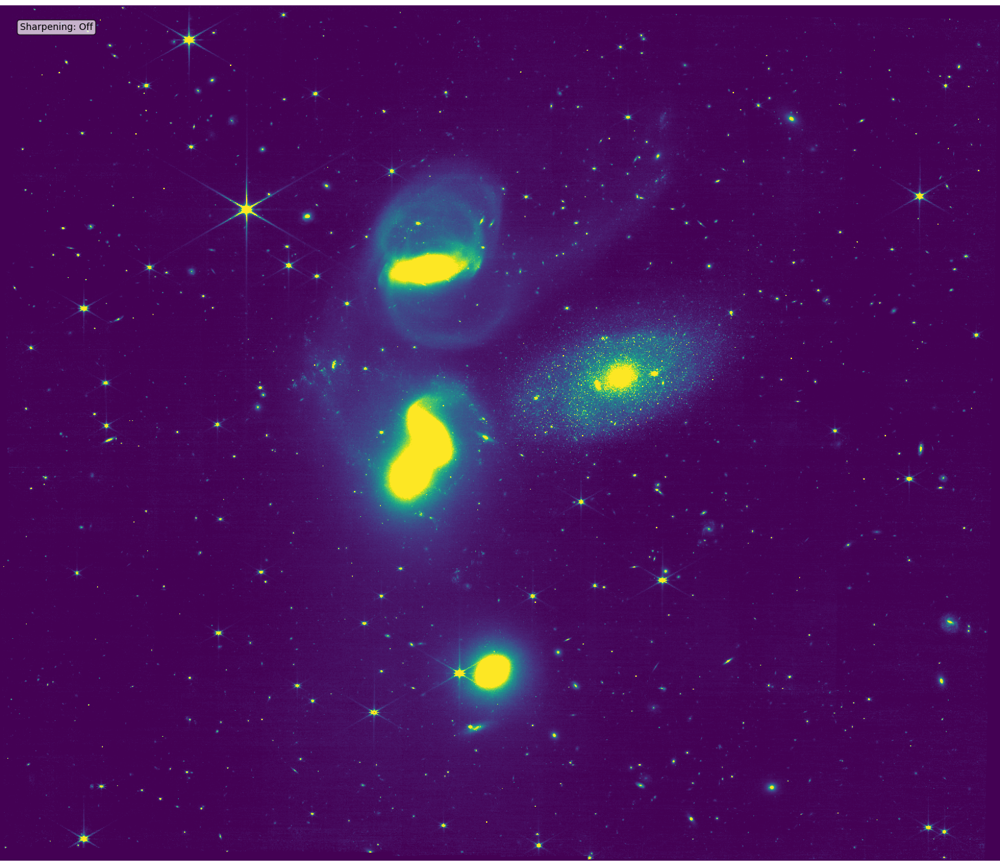


Done!


In [5]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F200W/JWST/jw02732-o001_t001_nircam_clear-f200w/jw02732-o001_t001_nircam_clear-f200w_i2d.fits'

create_plot(image)

# 18. create_plot
# 19. Read the FITS image
data: (6057, 7091)
Elapsed time for Reading FITS image: 0.3667 seconds
20. downsampled data: (606, 710)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 1.4646 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0149 seconds
Elapsed time for Total execution: 1.8476 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


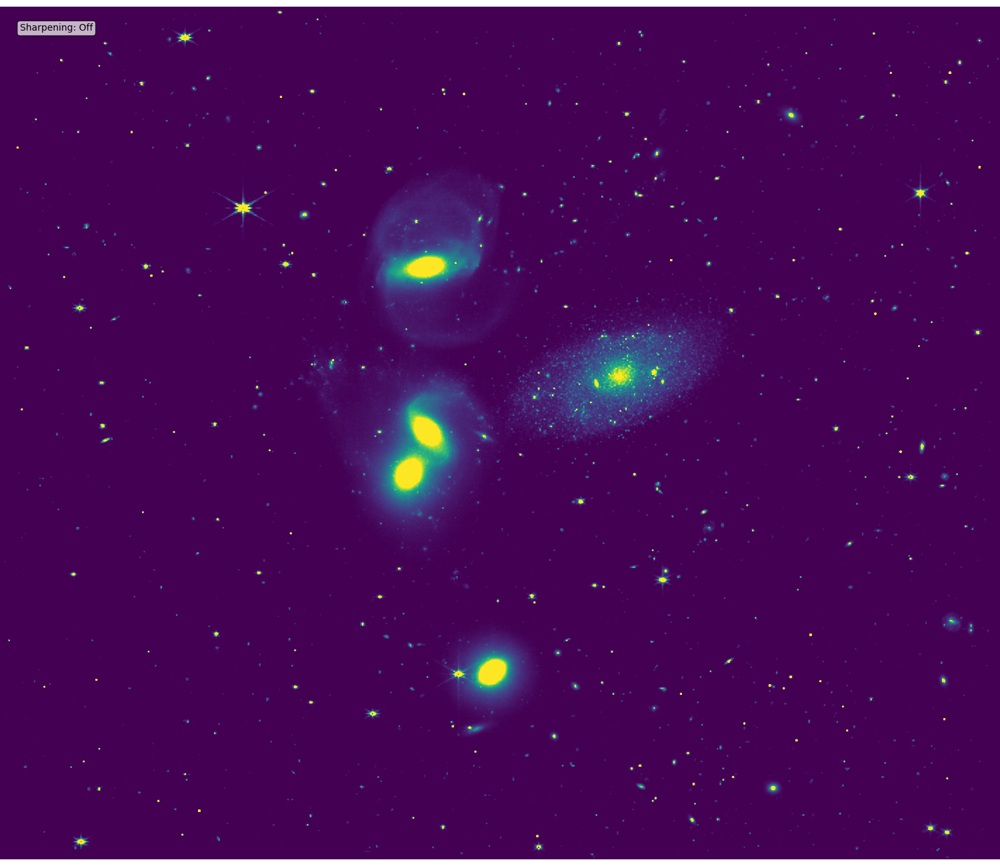


Done!


In [6]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F277W/JWST/jw02732-o001_t001_nircam_clear-f277w/jw02732-o001_t001_nircam_clear-f277w_i2d.fits'

create_plot(image)

# 18. create_plot
# 19. Read the FITS image
data: (6057, 7092)
Elapsed time for Reading FITS image: 0.1368 seconds
20. downsampled data: (606, 710)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 1.5015 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0195 seconds
Elapsed time for Total execution: 1.6580 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


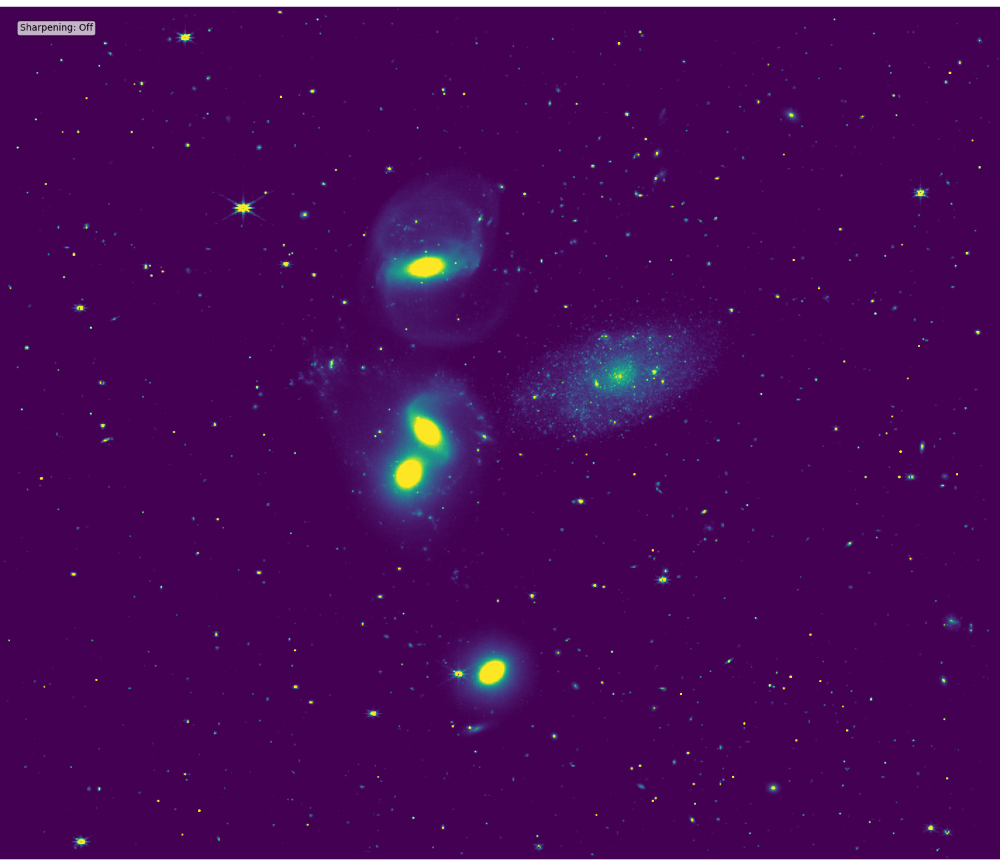


Done!


In [7]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F356W/JWST/jw02732-o001_t001_nircam_clear-f356w/jw02732-o001_t001_nircam_clear-f356w_i2d.fits'

create_plot(image)

# 18. create_plot
# 19. Read the FITS image
data: (6056, 7091)
Elapsed time for Reading FITS image: 0.6723 seconds
20. downsampled data: (606, 710)
Elapsed time for Downsampling data: 0.0000 seconds
# 21. Apply initial stretch (Linear)
Elapsed time for Applying initial stretch: 1.4910 seconds
#23. Create an image plot
# 24. Clear any existing figures
# 25. Create a single figure and axis
Elapsed time for Creating and displaying image plot: 0.0185 seconds
Elapsed time for Total execution: 2.1820 seconds
25b.Interact with the plot to change colormaps, zoom, or apply sharpening.
# 26. Create the stretch function dropdown
# 27. Create the colormap dropdown
# 28. Create the stretch description text box
# 29. Create the contrast slider
# 30. Create the zoom radio buttons
# 31. Create the sharpening radio buttons
# 32. Create a vertical box layout for all controls
# 33. Display all controls


# 34. Display the figure


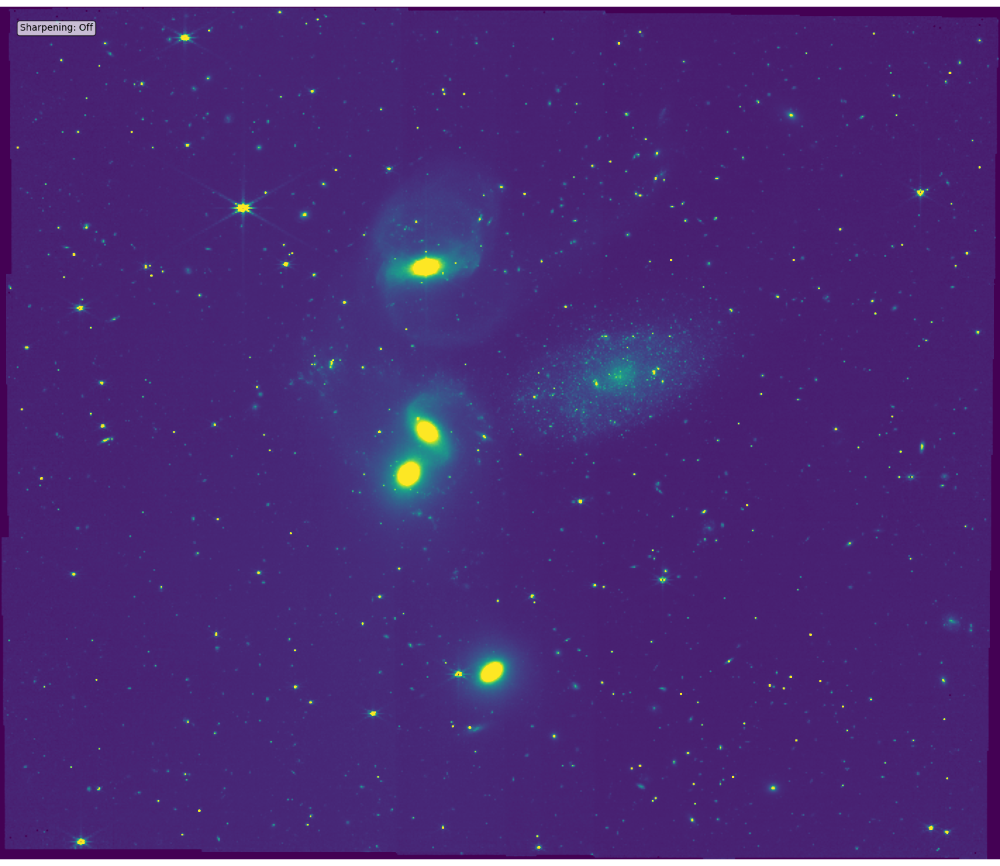


Done!


In [8]:
image = '/Volumes/HD_2021/JWST/NGC 7320 Stephans Quintet F444W/JWST/jw02732-o001_t001_nircam_clear-f444w/jw02732-o001_t001_nircam_clear-f444w_i2d.fits'

create_plot(image)